In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [2]:
data = pd.read_csv("data/ratings.csv")

temp = data.groupby(['userId', 'movieId']).size().reset_index(name='count')
movie_id = temp.groupby('movieId')['count'].sum().sort_values(ascending=False).head(400)
data_filtered = data[data["movieId"].isin(movie_id.index)]
data_sorted = data_filtered.sort_values(by="movieId", ascending=True)
movie_id = movie_id.sort_index()
movies = pd.read_csv("data/movies.csv")
movies = movies[movies["movieId"].isin(movie_id.index)]

In [3]:
genres = movies["genres"]

labels_list = []

for genre in genres.to_list():
    labels_list.append(genre.split("|"))

genres_dict = {}

for labels in labels_list:
    for label in labels:
        if label not in genres_dict:
            genres_dict[label] = 1
        else:
            genres_dict[label] = genres_dict[label] + 1

print(f"{len(genres_dict)} kinds of genre")

embedding_dict = {}
i = 0
for genre in genres_dict:
    embedding_dict[genre] = i
    i = i + 1

print(embedding_dict)

embedding_label = np.zeros((len(movies), len(genres_dict)))

for i in range(len(movies)):
    for genre in labels_list[i]:
        embedding_label[i][embedding_dict[genre]] = 1

19 kinds of genre
{'Adventure': 0, 'Animation': 1, 'Children': 2, 'Comedy': 3, 'Fantasy': 4, 'Action': 5, 'Crime': 6, 'Thriller': 7, 'Drama': 8, 'Romance': 9, 'Mystery': 10, 'Sci-Fi': 11, 'Musical': 12, 'Horror': 13, 'War': 14, 'IMAX': 15, 'Western': 16, 'Film-Noir': 17, 'Documentary': 18}


In [4]:
simplified_data = data_sorted.drop("timestamp",axis = 1)
simplified_data = simplified_data.reset_index(drop=True)
simplified_data.to_csv("data/simplified_data.csv",index=False)
np.savetxt("data/simplified_movieId.txt", movie_id.index.to_numpy().astype(int), fmt='%d')

In [5]:
def has_same_rating_user(df,movie1, movie2) -> bool:
    users_movie1 = set(df[df["movieId"] == movie1]["userId"])
    users_movie2 = set(df[df["movieId"] == movie2]["userId"])
    same_user = users_movie1.intersection(users_movie2)
    return len(same_user) > 0

In [6]:
import numpy as np
from tqdm import tqdm
from scipy.sparse import csr_matrix

data = np.loadtxt("data/simplified_data.csv",skiprows=1,delimiter=",")
movie_id = np.loadtxt("data/simplified_movieId.txt")
print(f"Number of unique movies to keep:{len(movie_id)}")
print(f"Number of rows to keep:{len(data)}")

Number of unique movies to keep:400
Number of rows to keep:9738067


In [7]:
#the first column is usrId, the second is movieId, the third is rate
def rate_to_index(rate):
    return np.floor(rate / 0.5).astype(np.int32) - 1

def to_pi(datas):
    result = []
    num_movies = len(movie_id)
    for movie in tqdm(range(num_movies)):
        ratings = datas[datas[:, 1] == movie_id[movie], 2]

        if len(ratings) == 0:
            result.append(np.zeros(10))
            continue

        indices = rate_to_index(ratings)

        counter = np.bincount(indices, minlength=10)
        p_i = counter / len(ratings)
        result.append(p_i)
    result = np.array(result)
    result[np.where(result <= 0)] = 1e-10
    return np.array(result)



def to_pij(datas,pi,pj):
    num_movies = len(movie_id)

    # 使用 NumPy 数组来存储每个电影对的稀疏矩阵对象
    result = np.empty((num_movies, num_movies), dtype=object)

    user_ids = datas[:, 0]
    movie_ids = datas[:, 1]
    rates = datas[:, 2]

    for i in tqdm(range(num_movies)):
        i_movie = movie_id[i]

        # 筛选出对电影 i 的所有评分记录
        mask_i = (movie_ids == i_movie)
        users_i = user_ids[mask_i]
        rates_i = rates[mask_i]
        indices_i = rate_to_index(rates_i)

        for j in range(i, num_movies):
            j_movie = movie_id[j]
            # 筛选出对电影 j 的所有评分记录
            mask_j = (movie_ids == j_movie)
            users_j = user_ids[mask_j]
            rates_j = rates[mask_j]
            indices_j = rate_to_index(rates_j)

            # 查找共同评分用户
            common_users_mask = np.isin(users_i, users_j)
            common_users = users_i[common_users_mask]

            if len(common_users) > 0:
                # 获取共同评分用户在 users_i 和 users_j 中的评分索引
                indices_i_common = indices_i[common_users_mask]
                indices_j_common = indices_j[np.isin(users_j, users_i)]

                # 创建空的计数矩阵
                counter = np.zeros((10, 10))

                # 使用高级索引进行累加操作
                for idx_i, idx_j in zip(indices_i_common, indices_j_common):
                    counter[idx_i, idx_j] += 1

                # 归一化操作1
                if np.sum(counter) > 0:
                    counter = counter / np.sum(counter)

                # 将计数矩阵转换为稀疏矩阵
                counter_sparse = csr_matrix(counter)
                # 存储稀疏矩阵到结果数组中
                result[i, j] = counter_sparse
                if i != j:
                    result[j, i] = counter_sparse.T
            else:
                result[i, j] = csr_matrix(np.outer(pi[i],pj[j]))
                if i != j:
                    result[j, i] = csr_matrix(np.outer(pi[i],pj[j]))

    return result

100%|██████████| 400/400 [00:08<00:00, 48.10it/s]


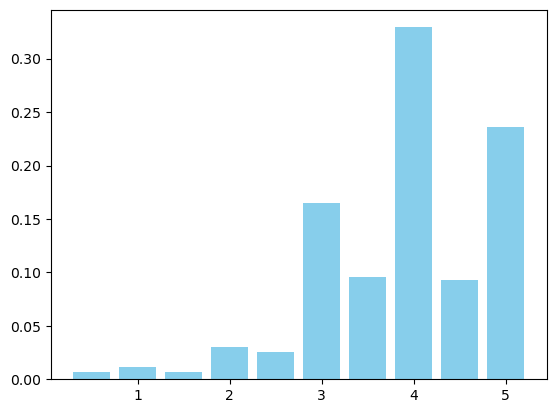

[0.0070844  0.01160376 0.00689246 0.03025703 0.02545848 0.16512241
 0.09558708 0.32933745 0.09298714 0.23566979]
[0.01085696 0.04162371 0.01875    0.1089884  0.06430412 0.34548969
 0.08195876 0.22084407 0.01498067 0.09220361]


In [8]:
x = np.arange(0.5, 5.5, 0.5)

pi = to_pi(data)

plt.bar(x, pi[0], width=0.5 * 0.8, color='skyblue', align='center')
plt.show()
print(pi[0])
print(pi[98])

In [9]:
import gc
gc.collect()

3708

In [10]:
pij = to_pij(data,pi,pi)

100%|██████████| 400/400 [32:54<00:00,  4.94s/it] 


In [11]:
N=400
m_vals = np.arange(0.5,5.5,0.5).reshape(1, -1)

E_X = (pi @ m_vals.T).squeeze()
E_X2 = (pi @ (m_vals.T ** 2)).squeeze()

m_vals_2d = m_vals.reshape(-1, 1) * m_vals.reshape(1, -1)
E_XY = np.zeros((N, N))
for i in range(N):
    for j in range(N):
        m_vals_2d = np.outer(m_vals.flatten(), m_vals.flatten())  
        E_XY[i, j] = pij[i, j].multiply(m_vals_2d).sum()

cov_XY = E_XY - np.outer(E_X, E_X)

var_X = E_X2 - E_X**2
std_X = np.sqrt(var_X)
std_X[std_X == 0] = 1e-10

pearson_matrix = cov_XY / np.outer(std_X, std_X)

print(pearson_matrix)
np.savetxt("temp/movie_pearson_matrix.txt",pearson_matrix,delimiter=",")

[[ 1.         -0.18481748 -0.25068715 ... -0.21868078 -0.34265673
   0.2820524 ]
 [-0.18481748  1.         -0.9978773  ...  0.29492761  0.29931121
   0.63915164]
 [-0.25068715 -0.9978773   1.         ... -0.44175793 -0.38798259
  -0.29458306]
 ...
 [-0.21868078  0.29492761 -0.44175793 ...  1.          0.23063813
  -0.07902286]
 [-0.34265673  0.29931121 -0.38798259 ...  0.23063813  1.
   0.05816874]
 [ 0.2820524   0.63915164 -0.29458306 ... -0.07902286  0.05816874
   1.        ]]


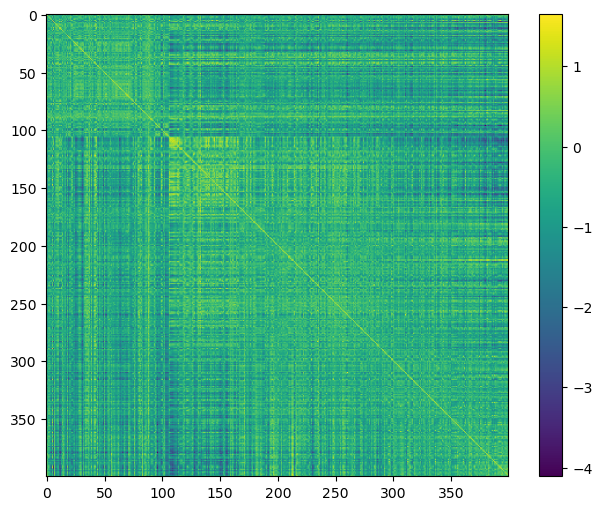

In [12]:
plt.figure(figsize=(8, 6))
plt.imshow(pearson_matrix)
plt.colorbar()
plt.savefig('imgs/pearson_matrix_movie.png')

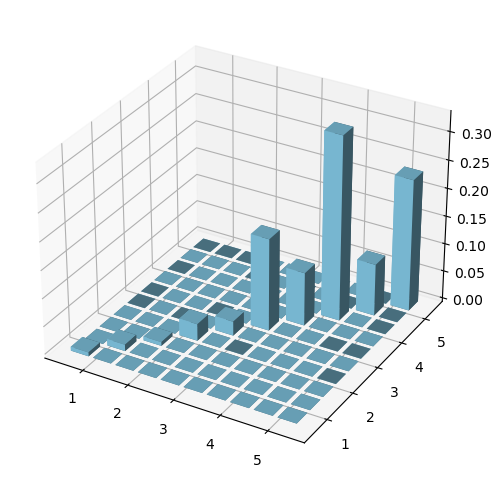

In [13]:
def draw_pij(i,j):
    pij_array = np.array(csr_matrix.toarray(pij[i,j]))
    x = np.arange(0.5, 5.5, 0.5)
    y = np.arange(0.5, 5.5, 0.5)

    xpos, ypos = np.meshgrid(x, y)
    xpos = xpos.flatten()
    ypos = ypos.flatten()

    zpos = np.zeros_like(xpos) 
    dx = dy = 0.4 
    dz = pij_array.flatten()

    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')

    ax.bar3d(xpos, ypos, zpos, dx, dy, dz, color='skyblue')
    plt.show()

draw_pij(0,0)

In [14]:
def MI(pi, pj, pij):
    num_movies = len(pij)
    result = np.zeros((num_movies, num_movies))
    epsilon = 1e-10  # 用于避免 log(0)

    for i in tqdm(range(num_movies)):
        for j in range(i, num_movies):  # 只计算上三角部分（包含对角线）
            # 转换为 NumPy 数组
            pi_array = np.array(pi[i])
            pj_array = np.array(pj[j])
            pij_array = csr_matrix.toarray(pij[i, j])
            
            # 避免 0 值
            pi_array = np.where(pi_array == 0, epsilon, pi_array)
            pj_array = np.where(pj_array == 0, epsilon, pj_array)
            pij_array = np.where(pij_array == 0, epsilon, pij_array)

            # 计算互信息，使用向量化操作
            temp_info = np.sum(pij_array * np.log2(pij_array / np.outer(pi_array[:, None] , pj_array[None, :])))

            # 将结果存储在对称位置
            result[i, j] = temp_info
            if i != j:
                result[j, i] = temp_info  # 利用对称性
    
    return result

mutual_info = MI(pi, pi, pij)

100%|██████████| 400/400 [00:02<00:00, 188.34it/s]


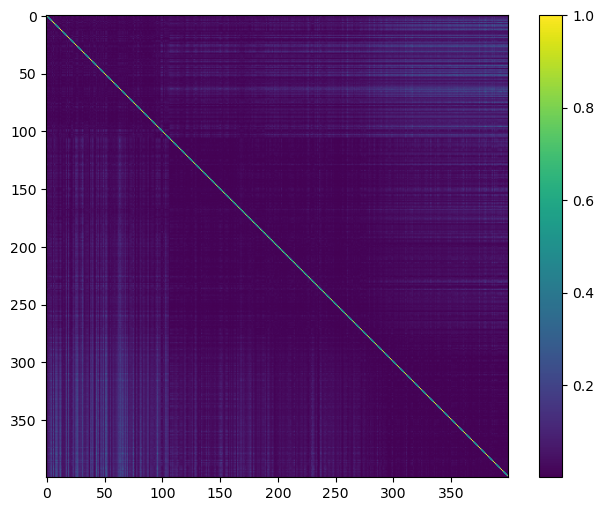

In [15]:
def normalize(mutual_info):
    D = np.diagonal(mutual_info)
    D_prime = 1 / np.sqrt(D)
    D_prime_matrix = np.diag(D_prime)
    normalized_mutual_info = D_prime_matrix @ mutual_info @ D_prime_matrix
    return normalized_mutual_info

plt.figure(figsize=(8, 6))
plt.imshow(normalize(mutual_info))
plt.colorbar()
plt.show()

In [16]:
np.savetxt("temp/sij.csv", mutual_info, delimiter=",")

In [20]:
import torch

mutual_info = torch.tensor(np.loadtxt("temp/sij.csv", delimiter=","))

In [21]:
def compute_P_C(P):
    return torch.sum(P,dim=0)/N

def compute_s_C(P, similarity_matrix, C):
    P_C = compute_P_C(P)
    P_column = P[:, C]
    norm_factor = P_C[C] ** 2
    s_C = torch.sum(similarity_matrix * torch.ger(P_column, P_column)) / norm_factor/(N**2)
    return s_C

In [22]:
def target_fc(P_C_i, T):  
    epsilon = 1e-10
    # P_C_i_normalized = P_C_i / P_C_i.sum(dim=1, keepdims=True).clamp(min=1e-10)
    # P_C_i = P_C_i_normalized.clamp(min=epsilon)
    P_C_i = torch.softmax(P_C_i,dim = 1)  
    P_C = compute_P_C(P_C_i)
    
    N, Nc = P_C_i.shape
    s_C = torch.zeros(Nc)
    for i in range(Nc):
      s_C[i] = compute_s_C(P_C_i, mutual_info, i)
    s_all_clusters = torch.dot(s_C, P_C)
    info = torch.sum(P_C_i * torch.log2(P_C_i / P_C)) / N
    return -s_all_clusters + T * info

def train(epoch,N,Nc,T,loss_array = None,lr = 1e-3):
    P_C_i = torch.rand(N,Nc,requires_grad=True)
    optimizer = torch.optim.Adam([P_C_i],lr)

    for i in range(epoch):
        optimizer.zero_grad()
        loss = target_fc(P_C_i,T)
        loss.backward()
        optimizer.step()
        print(f"Epoch:{i}, loss:{loss.item()}")
        if loss_array is not None:
          loss_array.append(loss.item())
    if loss_array is not None:
      loss_array = np.array(loss_array)
    return torch.softmax(P_C_i,dim=1)

In [40]:
T = 1/50
Nc = len(embedding_dict)
N = len(movie_id)
     
loss_array = []    
P_C_i = train(40000,N,Nc,T,loss_array,lr=5e-4)
np.savetxt("temp/movie_opt_P_C_i.csv",P_C_i.detach().numpy(),delimiter=",")

Epoch:0, loss:-0.10574460029602051
Epoch:1, loss:-0.10574662685394287
Epoch:2, loss:-0.10574863106012344
Epoch:3, loss:-0.10575065016746521
Epoch:4, loss:-0.10575263947248459
Epoch:5, loss:-0.10575462132692337
Epoch:6, loss:-0.10575660318136215
Epoch:7, loss:-0.10575858503580093
Epoch:8, loss:-0.10576055198907852
Epoch:9, loss:-0.10576250404119492
Epoch:10, loss:-0.1057644635438919
Epoch:11, loss:-0.1057664006948471
Epoch:12, loss:-0.10576833784580231
Epoch:13, loss:-0.10577026009559631
Epoch:14, loss:-0.10577218234539032
Epoch:15, loss:-0.10577408969402313
Epoch:16, loss:-0.10577598214149475
Epoch:17, loss:-0.10577788949012756
Epoch:18, loss:-0.10577976703643799
Epoch:19, loss:-0.10578165203332901
Epoch:20, loss:-0.10578352957963943
Epoch:21, loss:-0.10578538477420807
Epoch:22, loss:-0.1057872399687767
Epoch:23, loss:-0.10578909516334534
Epoch:24, loss:-0.10579092800617218
Epoch:25, loss:-0.10579276829957962
Epoch:26, loss:-0.10579460114240646
Epoch:27, loss:-0.10579642653465271
Epoch

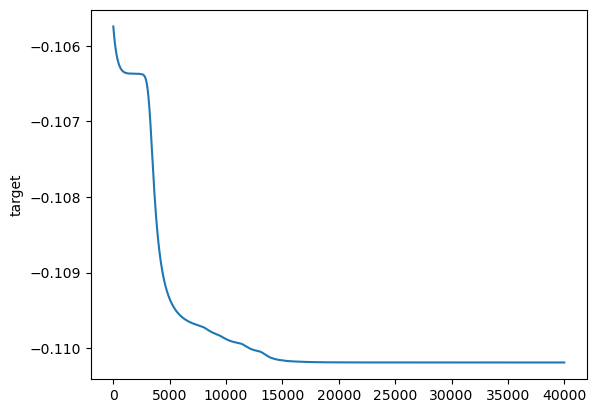

In [41]:
import matplotlib.pyplot as plt

x = np.arange(0,40000,1)
plt.plot(x,loss_array)
plt.ylabel("target")
plt.savefig("imgs/movie_loss.png")

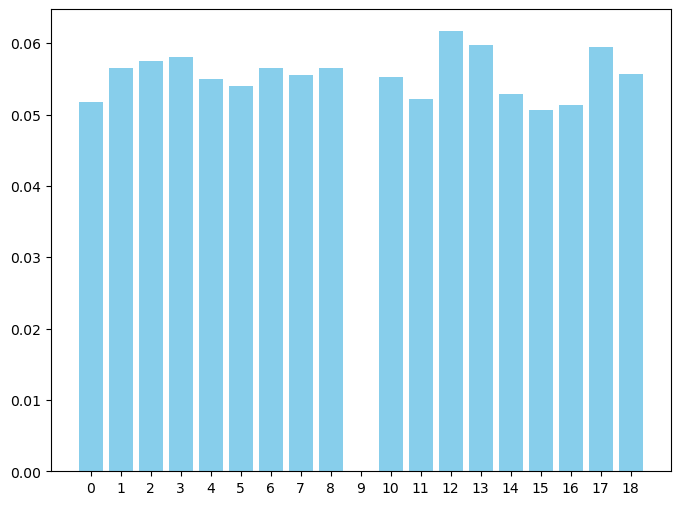

0.061670709401369095


In [42]:
P_C_i = np.loadtxt("temp/movie_opt_P_C_i.csv",delimiter=",")

def draw(P_C_i,i):
    plt.figure(figsize=(8, 6))
    x = np.arange(0, len(P_C_i[i]), 1)
    plt.bar(x, P_C_i[i], width=0.8, color='skyblue', align='center')
    plt.xticks(x)
    plt.show()
    print(np.max(P_C_i[i]))
    
draw(P_C_i,0)

Epoch:0, loss:-0.1057753711938858
Epoch:1, loss:-0.10577721893787384
Epoch:2, loss:-0.10577906668186188
Epoch:3, loss:-0.10578091442584991
Epoch:4, loss:-0.10578274726867676
Epoch:5, loss:-0.1057845801115036
Epoch:6, loss:-0.10578640550374985
Epoch:7, loss:-0.1057882234454155
Epoch:8, loss:-0.10579003393650055
Epoch:9, loss:-0.1057918444275856
Epoch:10, loss:-0.10579364001750946
Epoch:11, loss:-0.10579544305801392
Epoch:12, loss:-0.10579723119735718
Epoch:13, loss:-0.10579900443553925
Epoch:14, loss:-0.10580079257488251
Epoch:15, loss:-0.10580255836248398
Epoch:16, loss:-0.10580431669950485
Epoch:17, loss:-0.10580607503652573
Epoch:18, loss:-0.1058078333735466
Epoch:19, loss:-0.10580958425998688
Epoch:20, loss:-0.10581132769584656
Epoch:21, loss:-0.10581306368112564
Epoch:22, loss:-0.10581477731466293
Epoch:23, loss:-0.10581652075052261
Epoch:24, loss:-0.10581821948289871
Epoch:25, loss:-0.105819933116436
Epoch:26, loss:-0.1058216467499733
Epoch:27, loss:-0.1058233454823494
Epoch:28, l

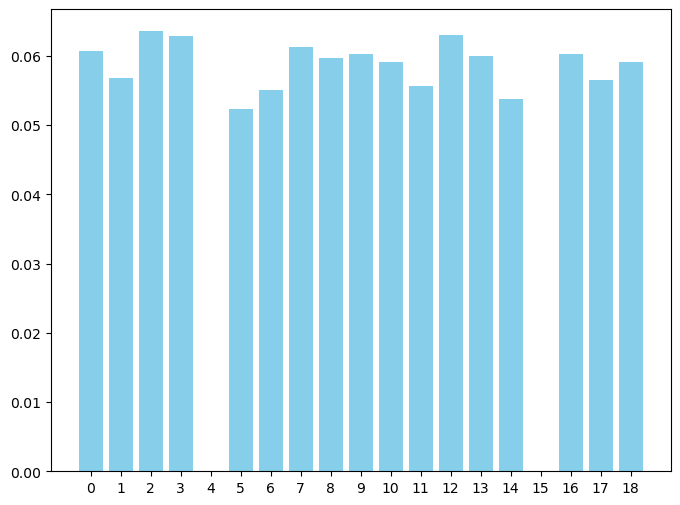

0.06355144
Epoch:0, loss:-0.10579532384872437
Epoch:1, loss:-0.10579720884561539
Epoch:2, loss:-0.10579907894134521
Epoch:3, loss:-0.10580093413591385
Epoch:4, loss:-0.10580278933048248
Epoch:5, loss:-0.10580462962388992
Epoch:6, loss:-0.10580646991729736
Epoch:7, loss:-0.1058083102107048
Epoch:8, loss:-0.10581012815237045
Epoch:9, loss:-0.1058119460940361
Epoch:10, loss:-0.10581375658512115
Epoch:11, loss:-0.10581555217504501
Epoch:12, loss:-0.10581734776496887
Epoch:13, loss:-0.10581912100315094
Epoch:14, loss:-0.1058209091424942
Epoch:15, loss:-0.10582266002893448
Epoch:16, loss:-0.10582441836595535
Epoch:17, loss:-0.10582618415355682
Epoch:18, loss:-0.10582792013883591
Epoch:19, loss:-0.10582965612411499
Epoch:20, loss:-0.10583138465881348
Epoch:21, loss:-0.10583311319351196
Epoch:22, loss:-0.10583481192588806
Epoch:23, loss:-0.10583651810884476
Epoch:24, loss:-0.10583821684122086
Epoch:25, loss:-0.10583990812301636
Epoch:26, loss:-0.10584159195423126
Epoch:27, loss:-0.105843275785

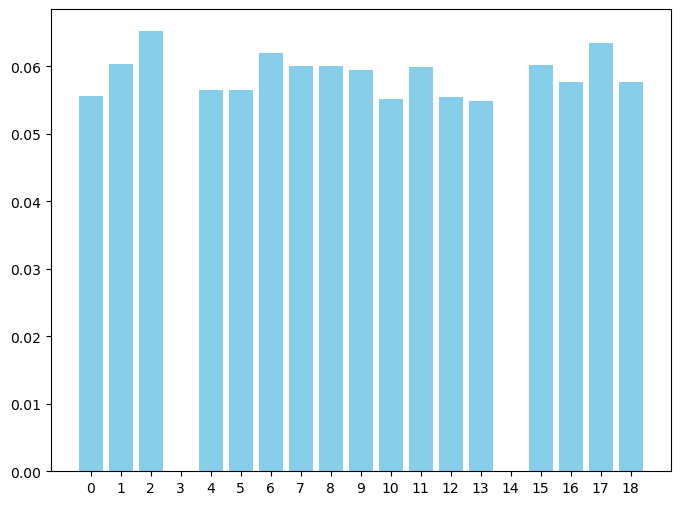

0.065195955
Epoch:0, loss:-0.10581164807081223
Epoch:1, loss:-0.10581345856189728
Epoch:2, loss:-0.10581526160240173
Epoch:3, loss:-0.10581705719232559
Epoch:4, loss:-0.10581883788108826
Epoch:5, loss:-0.10582061856985092
Epoch:6, loss:-0.10582238435745239
Epoch:7, loss:-0.10582415014505386
Epoch:8, loss:-0.10582589358091354
Epoch:9, loss:-0.10582765191793442
Epoch:10, loss:-0.1058293953537941
Epoch:11, loss:-0.10583112388849258
Epoch:12, loss:-0.10583284497261047
Epoch:13, loss:-0.10583457350730896
Epoch:14, loss:-0.10583629459142685
Epoch:15, loss:-0.10583798587322235
Epoch:16, loss:-0.10583966970443726
Epoch:17, loss:-0.10584136843681335
Epoch:18, loss:-0.10584304481744766
Epoch:19, loss:-0.10584472119808197
Epoch:20, loss:-0.10584639012813568
Epoch:21, loss:-0.1058480441570282
Epoch:22, loss:-0.10584970563650131
Epoch:23, loss:-0.10585133731365204
Epoch:24, loss:-0.10585298389196396
Epoch:25, loss:-0.10585460811853409
Epoch:26, loss:-0.10585623234510422
Epoch:27, loss:-0.1058578565

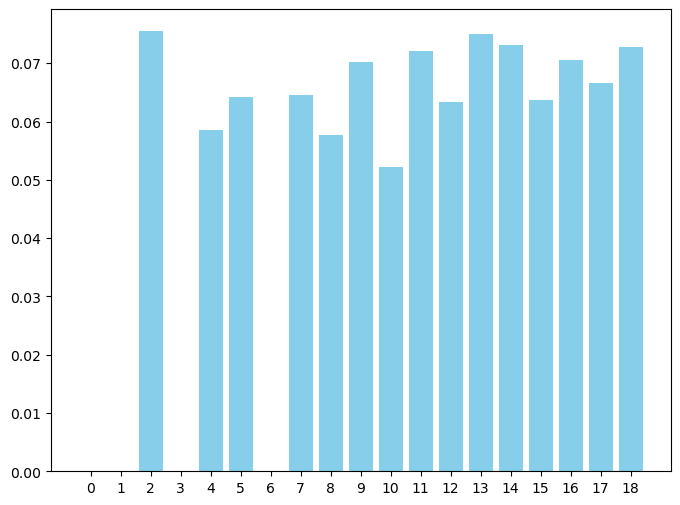

0.07548661
Epoch:0, loss:-0.10583414882421494
Epoch:1, loss:-0.10583585500717163
Epoch:2, loss:-0.10583755373954773
Epoch:3, loss:-0.10583925247192383
Epoch:4, loss:-0.10584093630313873
Epoch:5, loss:-0.10584262013435364
Epoch:6, loss:-0.10584428906440735
Epoch:7, loss:-0.10584595799446106
Epoch:8, loss:-0.10584761947393417
Epoch:9, loss:-0.10584927350282669
Epoch:10, loss:-0.10585091263055801
Epoch:11, loss:-0.10585255175828934
Epoch:12, loss:-0.10585417598485947
Epoch:13, loss:-0.1058558002114296
Epoch:14, loss:-0.10585742443799973
Epoch:15, loss:-0.10585903376340866
Epoch:16, loss:-0.105860635638237
Epoch:17, loss:-0.10586223006248474
Epoch:18, loss:-0.10586383193731308
Epoch:19, loss:-0.10586541891098022
Epoch:20, loss:-0.10586699843406677
Epoch:21, loss:-0.10586856305599213
Epoch:22, loss:-0.10587013512849808
Epoch:23, loss:-0.10587169975042343
Epoch:24, loss:-0.10587325692176819
Epoch:25, loss:-0.10587479919195175
Epoch:26, loss:-0.10587634146213531
Epoch:27, loss:-0.105877883732

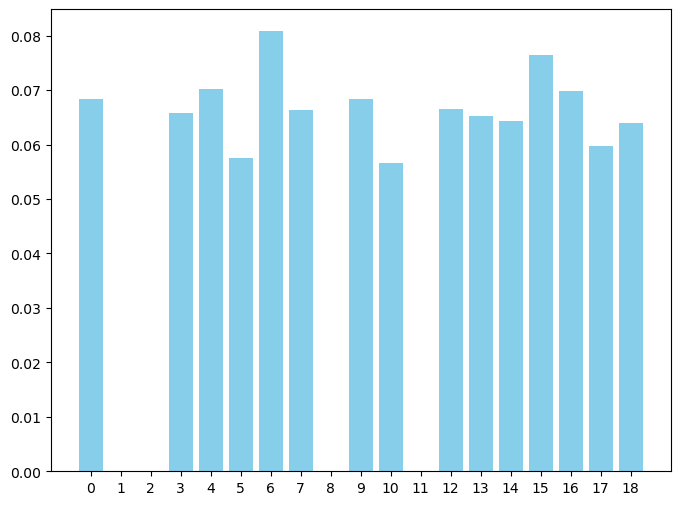

0.08080441
Epoch:0, loss:-0.10586152225732803
Epoch:1, loss:-0.10586316138505936
Epoch:2, loss:-0.10586478561162949
Epoch:3, loss:-0.10586640238761902
Epoch:4, loss:-0.10586801171302795
Epoch:5, loss:-0.10586963593959808
Epoch:6, loss:-0.10587123036384583
Epoch:7, loss:-0.10587283223867416
Epoch:8, loss:-0.10587440431118011
Epoch:9, loss:-0.10587599128484726
Epoch:10, loss:-0.10587757080793381
Epoch:11, loss:-0.10587914288043976
Epoch:12, loss:-0.10588069260120392
Epoch:13, loss:-0.10588224977254868
Epoch:14, loss:-0.10588379949331284
Epoch:15, loss:-0.1058853417634964
Epoch:16, loss:-0.10588687658309937
Epoch:17, loss:-0.10588840395212173
Epoch:18, loss:-0.10588992387056351
Epoch:19, loss:-0.10589144378900528
Epoch:20, loss:-0.10589294880628586
Epoch:21, loss:-0.10589445382356644
Epoch:22, loss:-0.10589595884084702
Epoch:23, loss:-0.1058974489569664
Epoch:24, loss:-0.10589893162250519
Epoch:25, loss:-0.10590040683746338
Epoch:26, loss:-0.10590188950300217
Epoch:27, loss:-0.10590335726

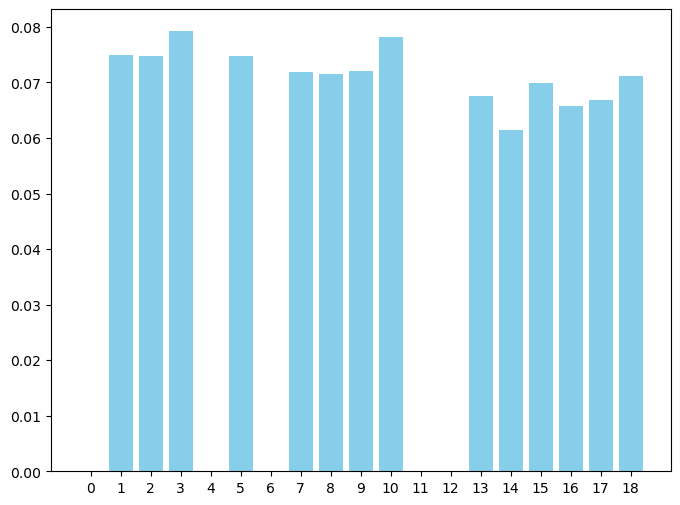

0.07920682


In [43]:
for t in range(51,56,1):
  P_C_i = train(40000,N,Nc,1/t,loss_array,lr=5e-4)
  draw(P_C_i.detach().numpy(),0)

Epoch:0, loss:-0.10586905479431152
Epoch:1, loss:-0.10587061196565628
Epoch:2, loss:-0.10587215423583984
Epoch:3, loss:-0.10587369650602341
Epoch:4, loss:-0.10587523132562637
Epoch:5, loss:-0.10587675124406815
Epoch:6, loss:-0.10587826371192932
Epoch:7, loss:-0.10587979108095169
Epoch:8, loss:-0.10588130354881287
Epoch:9, loss:-0.10588281601667404
Epoch:10, loss:-0.10588430613279343
Epoch:11, loss:-0.10588580369949341
Epoch:12, loss:-0.10588730126619339
Epoch:13, loss:-0.10588877648115158
Epoch:14, loss:-0.10589025169610977
Epoch:15, loss:-0.10589172691106796
Epoch:16, loss:-0.10589319467544556
Epoch:17, loss:-0.10589464753866196
Epoch:18, loss:-0.10589610785245895
Epoch:19, loss:-0.10589756071567535
Epoch:20, loss:-0.10589900612831116
Epoch:21, loss:-0.10590044409036636
Epoch:22, loss:-0.10590188205242157
Epoch:23, loss:-0.10590331256389618
Epoch:24, loss:-0.10590473562479019
Epoch:25, loss:-0.1059061586856842
Epoch:26, loss:-0.10590758174657822
Epoch:27, loss:-0.10590898990631104
Epo

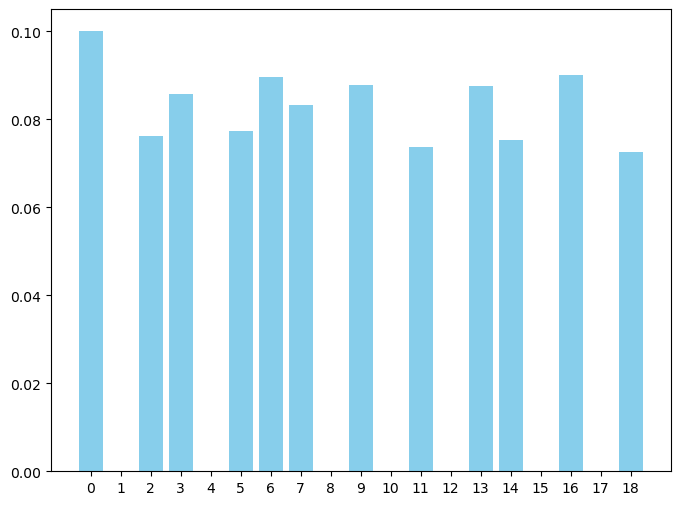

0.100042865
Epoch:0, loss:-0.10589050501585007
Epoch:1, loss:-0.10589201748371124
Epoch:2, loss:-0.10589352995157242
Epoch:3, loss:-0.1058950424194336
Epoch:4, loss:-0.10589653253555298
Epoch:5, loss:-0.10589803755283356
Epoch:6, loss:-0.10589952021837234
Epoch:7, loss:-0.10590099543333054
Epoch:8, loss:-0.10590247064828873
Epoch:9, loss:-0.10590393841266632
Epoch:10, loss:-0.10590540617704391
Epoch:11, loss:-0.10590685904026031
Epoch:12, loss:-0.10590831935405731
Epoch:13, loss:-0.10590975731611252
Epoch:14, loss:-0.10591119527816772
Epoch:15, loss:-0.10591262578964233
Epoch:16, loss:-0.10591405630111694
Epoch:17, loss:-0.10591547936201096
Epoch:18, loss:-0.10591689497232437
Epoch:19, loss:-0.10591831803321838
Epoch:20, loss:-0.10591971129179001
Epoch:21, loss:-0.10592111200094223
Epoch:22, loss:-0.10592249780893326
Epoch:23, loss:-0.10592389851808548
Epoch:24, loss:-0.10592527687549591
Epoch:25, loss:-0.10592665523290634
Epoch:26, loss:-0.10592803359031677
Epoch:27, loss:-0.105929389

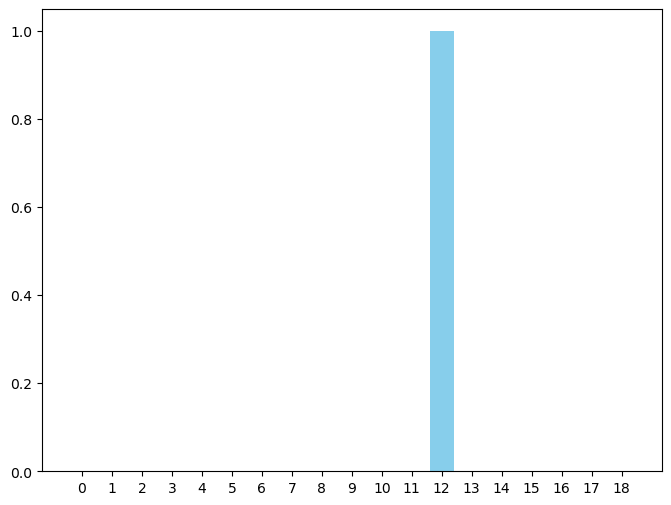

0.9999974
Epoch:0, loss:-0.10589863359928131
Epoch:1, loss:-0.10590030252933502
Epoch:2, loss:-0.10590194910764694
Epoch:3, loss:-0.10590358078479767
Epoch:4, loss:-0.10590521991252899
Epoch:5, loss:-0.10590684413909912
Epoch:6, loss:-0.10590844601392746
Epoch:7, loss:-0.1059100553393364
Epoch:8, loss:-0.10591164231300354
Epoch:9, loss:-0.10591322183609009
Epoch:10, loss:-0.10591480135917664
Epoch:11, loss:-0.1059163510799408
Epoch:12, loss:-0.10591791570186615
Epoch:13, loss:-0.10591944307088852
Epoch:14, loss:-0.10592097043991089
Epoch:15, loss:-0.10592249035835266
Epoch:16, loss:-0.10592399537563324
Epoch:17, loss:-0.10592550784349442
Epoch:18, loss:-0.1059269979596138
Epoch:19, loss:-0.10592848062515259
Epoch:20, loss:-0.10592994838953018
Epoch:21, loss:-0.10593141615390778
Epoch:22, loss:-0.10593286901712418
Epoch:23, loss:-0.10593432188034058
Epoch:24, loss:-0.10593575984239578
Epoch:25, loss:-0.1059371829032898
Epoch:26, loss:-0.10593860596418381
Epoch:27, loss:-0.10594001412391

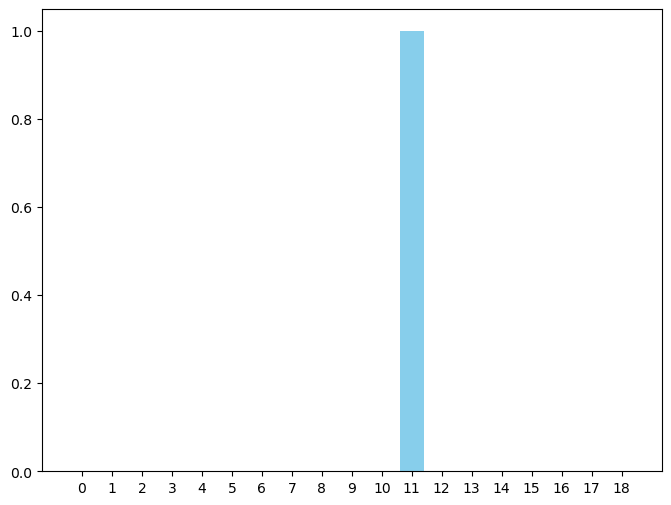

0.999998
Epoch:0, loss:-0.10592092573642731
Epoch:1, loss:-0.1059224009513855
Epoch:2, loss:-0.10592388361692429
Epoch:3, loss:-0.10592535883188248
Epoch:4, loss:-0.10592681914567947
Epoch:5, loss:-0.10592826455831528
Epoch:6, loss:-0.10592972487211227
Epoch:7, loss:-0.10593117028474808
Epoch:8, loss:-0.10593259334564209
Epoch:9, loss:-0.1059340238571167
Epoch:10, loss:-0.10593544691801071
Epoch:11, loss:-0.10593685507774353
Epoch:12, loss:-0.10593825578689575
Epoch:13, loss:-0.10593965649604797
Epoch:14, loss:-0.1059410572052002
Epoch:15, loss:-0.10594243556261063
Epoch:16, loss:-0.10594381392002106
Epoch:17, loss:-0.10594518482685089
Epoch:18, loss:-0.10594654828310013
Epoch:19, loss:-0.10594790428876877
Epoch:20, loss:-0.10594926029443741
Epoch:21, loss:-0.10595060139894485
Epoch:22, loss:-0.1059519425034523
Epoch:23, loss:-0.10595327615737915
Epoch:24, loss:-0.1059545949101448
Epoch:25, loss:-0.10595590621232986
Epoch:26, loss:-0.10595721751451492
Epoch:27, loss:-0.1059585362672805

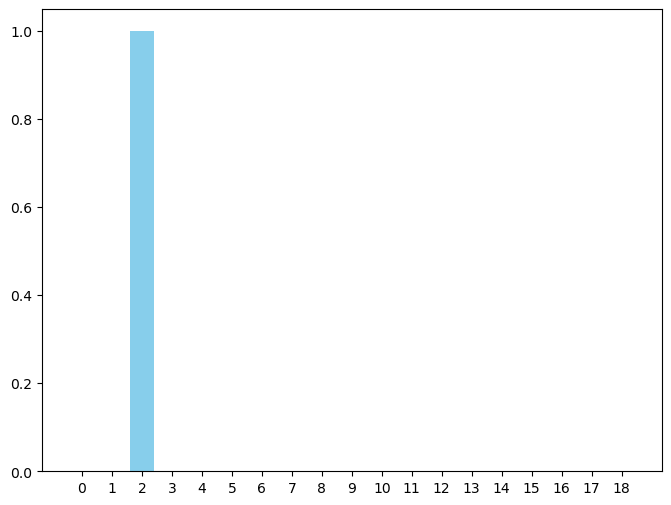

0.99999845
Epoch:0, loss:-0.10592561215162277
Epoch:1, loss:-0.10592708736658096
Epoch:2, loss:-0.10592854768037796
Epoch:3, loss:-0.10593000054359436
Epoch:4, loss:-0.10593143850564957
Epoch:5, loss:-0.10593289136886597
Epoch:6, loss:-0.10593432933092117
Epoch:7, loss:-0.10593573749065399
Epoch:8, loss:-0.105937160551548
Epoch:9, loss:-0.10593856126070023
Epoch:10, loss:-0.10593996196985245
Epoch:11, loss:-0.10594134777784348
Epoch:12, loss:-0.1059427410364151
Epoch:13, loss:-0.10594410449266434
Epoch:14, loss:-0.10594549030065536
Epoch:15, loss:-0.10594683885574341
Epoch:16, loss:-0.10594819486141205
Epoch:17, loss:-0.1059495359659195
Epoch:18, loss:-0.10595087707042694
Epoch:19, loss:-0.10595221072435379
Epoch:20, loss:-0.10595353692770004
Epoch:21, loss:-0.1059548482298851
Epoch:22, loss:-0.10595617443323135
Epoch:23, loss:-0.10595747083425522
Epoch:24, loss:-0.10595877468585968
Epoch:25, loss:-0.10596005618572235
Epoch:26, loss:-0.10596133768558502
Epoch:27, loss:-0.10596261918544

In [ ]:
for t in range(56,61,1):
  P_C_i = train(40000,N,Nc,1/t,loss_array,lr=5e-4)
  draw(P_C_i.detach().numpy(),0)